# Advanced Lane Finding

**Advanced Lane Finding Project**

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## 1. Camera Calibration

### 1. Briefly state how you computed the camera matrix and distortion coefficients. Provide an example of a distortion corrected calibration image.

The code for this step is contained in the first code cell of the IPython notebook located in "./examples/example.ipynb" (or in lines # through # of the file called `some_file.py`).  

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image.  Thus, `objp` is just a replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image.  `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.  

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` function.  I applied this distortion correction to the test image using the `cv2.undistort()` function and obtained this result: 

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

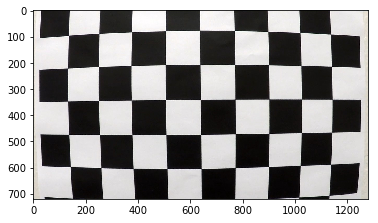

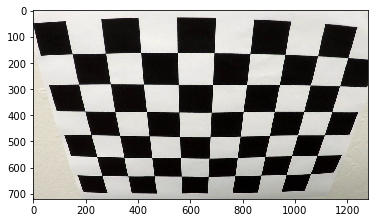

In [2]:
# Read in one of the calibration image and show
correct_1 = mpimg.imread('camera_cal/calibration1.jpg')
plt.imshow(correct_1)
plt.show()
correct_2 = mpimg.imread('camera_cal/calibration2.jpg')
plt.imshow(correct_2)
plt.show()

We can see that these chessboards have 9x6 shapes, next we'll use these parameters to calibrate camera

### 1.1 Find object points and image points to calibrate camera ###

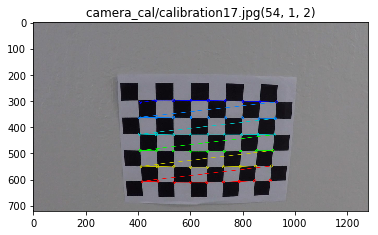

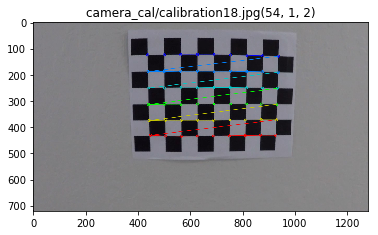

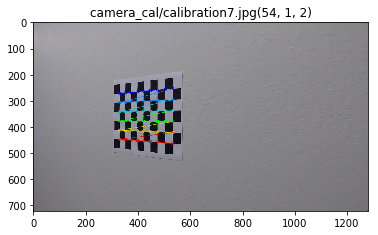

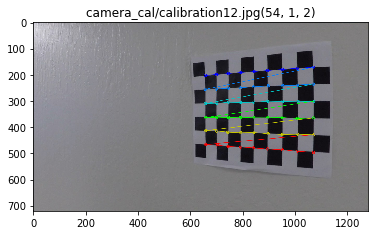

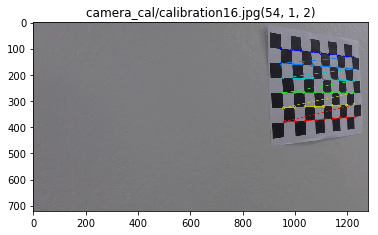

...

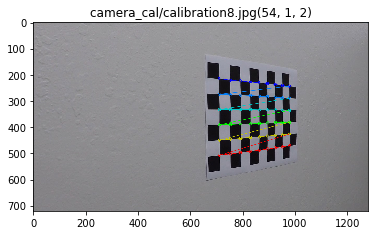

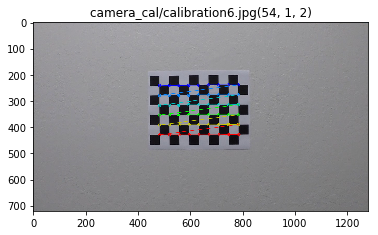

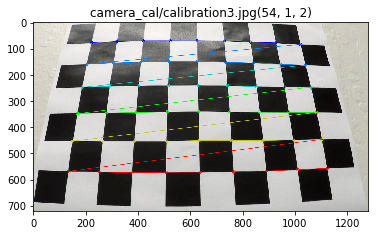

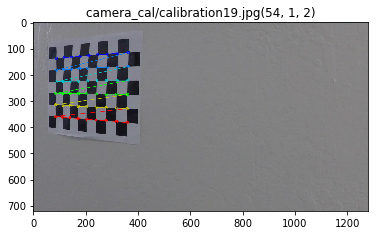

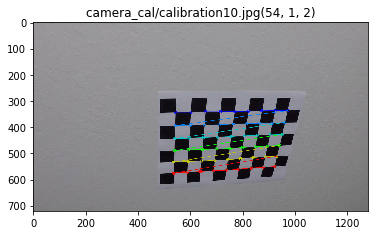

In [32]:
import glob
# %matplotlib qt

# read in all images and store in an array
images = glob.glob('camera_cal/calibration*.jpg')

# print(len(images))

# chessboard cols and rows number
cb_col,cb_row = 9,6
chessboard_dim = (cb_col,cb_row)

# # arrays to store object points in 3D and image points in 2D
objpoints = [] # 3D points in real world space 
imgpoints = [] # 2D points in image plane

# # prepare object points, like (0,0,0),(1,0,0)...
objp = np.zeros((cb_row*cb_col,3),np.float32)
objp[:,:2] = np.mgrid[0:cb_col,0:cb_row].T.reshape(-1,2) # x,y coordinates

# iterate over all images and fill in objpoints and imgpoints
for frame in images:
    # read in each image
    image = mpimg.imread(frame)
    
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim)
    cv2.drawChessboardCorners(image, chessboard_dim, corners, ret)
    
    # if corners are found, add object points and image points
    if ret:
        imgpoints.append(corners)
        objpoints.append(objp)
        # draw and display corners for last image
        img = cv2.drawChessboardCorners(image, chessboard_dim,corners,ret)
        plt.imshow(img)
        objpn = np.array(corners)
        plt.title(frame+str(objpn.shape))
        plt.show()

### 1.2 Use the object points and image points found above to calibrate camera ###

In [ ]:
# takes an image, object points, and image points
# performs the camera calibration, image distortion correction and 
# returns the undistorted image
def cal_undistort(image):
    img = np.copy(image)
    undist = img
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim, None)
    img = cv2.drawChessboardCorners(img, chessboard_dim, corners, ret)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist,retb

for image in images:    
    test_img = mpimg.imread(image)
    undistorted,ret = cal_undistort(test_img)
    if not ret:
        print('image:{} is not processed'.format(image))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 9))
    f.tight_layout()
    ax1.imshow(test_img)
    ax1.set_title('Original Image', fontsize=12)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=12)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

** We can see that all test images are well undistorted, so we can proceed to next step. **

### 1.3  Transform image perspective ###

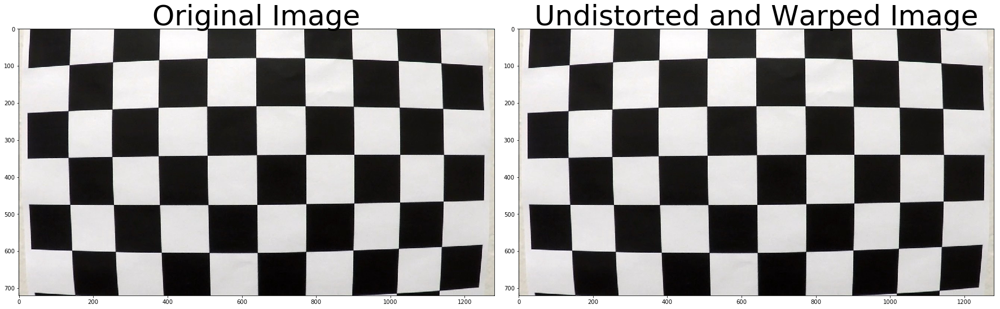

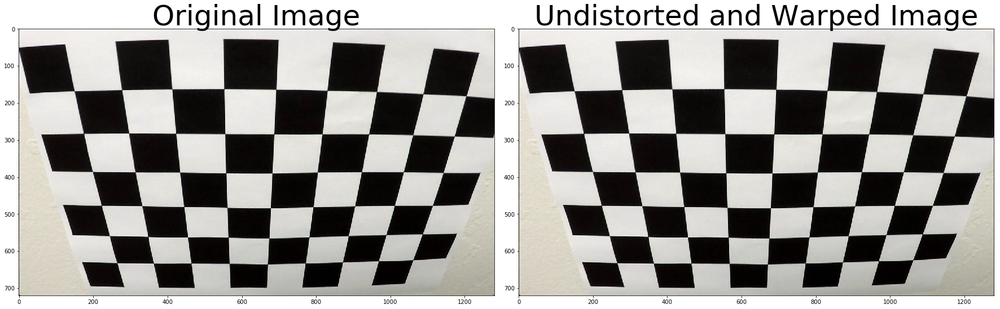

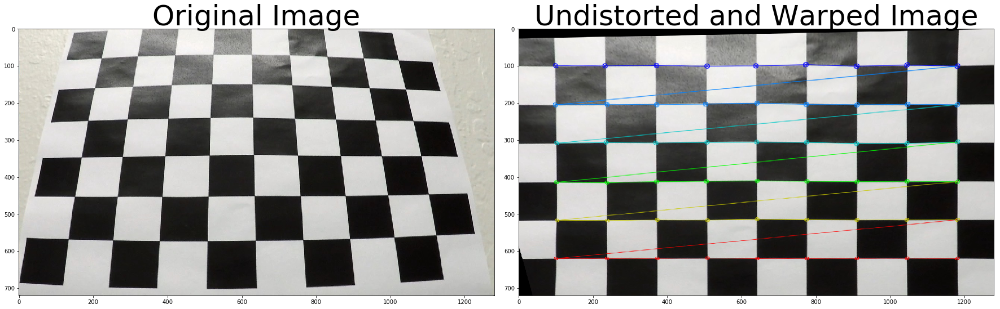

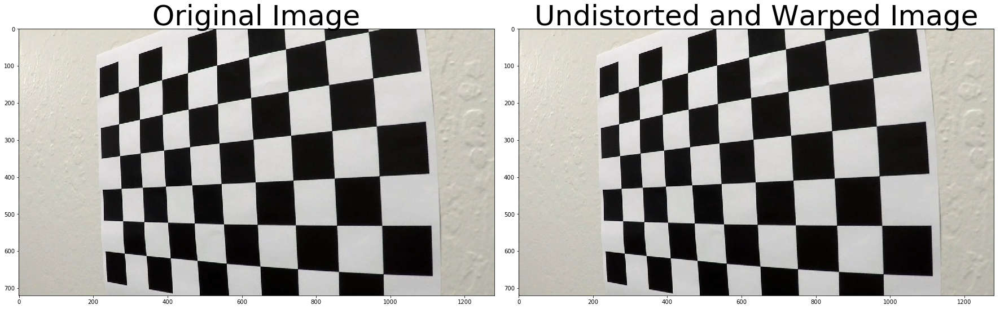

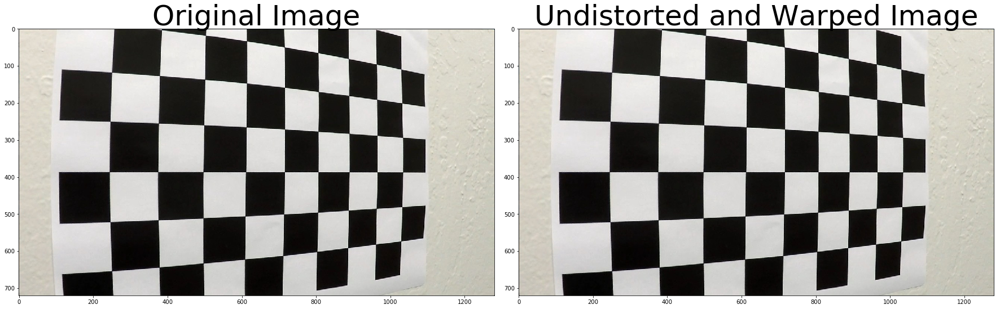

In [29]:
# transform image perspective
def corners_unwarp(img):
    
    # Undistort using mtx and dist
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert to grayscale
    gray = cv2.cvtColor(undist,cv2.COLOR_RGB2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim, None)
#     cv2.drawChessboardCorners(undist, chessboard_dim, corners, ret)
    warped, M, Minv = img,None,None
    if ret:
        cv2.drawChessboardCorners(undist, chessboard_dim, corners, ret)
        img_size = gray.shape[::-1]
        offset = 100
        src = np.float32([corners[0],corners[cb_col-1],corners[-1],corners[-cb_col]])
        # define 4 destination points                
        dst = np.float32([[offset,offset],
                          [img_size[0]-offset,offset],
                          [img_size[0]-offset,img_size[1]-offset],
                          [offset,img_size[1]-offset]])
        # get M and Minv, the transform matrix and the inverse matrix
        M = cv2.getPerspectiveTransform(src, dst)
        Minv = cv2.getPerspectiveTransform(dst,src)
        # warp image to a top-down view
        warped = cv2.warpPerspective(undist, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped, M, Minv

for image in images:    
    test_img = mpimg.imread(image)  
    top_down, perspective_M, perspective_Minv = corners_unwarp(test_img)
        
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(test_img)
    ax1.set_title('Original Image', fontsize=50)
    
    ax2.imshow(top_down)
    ax2.set_title('Undistorted and Warped Image', fontsize=50)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

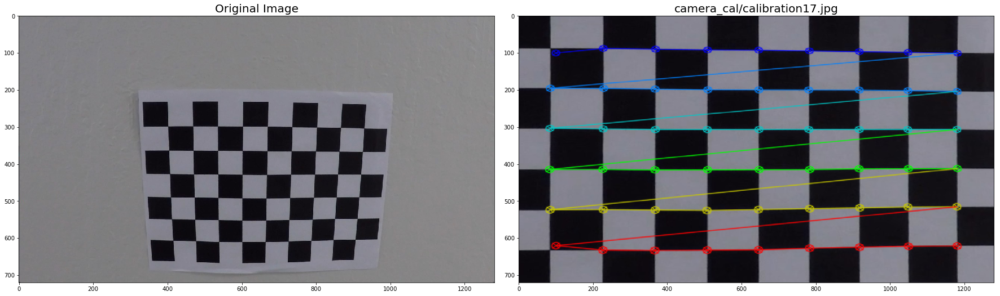

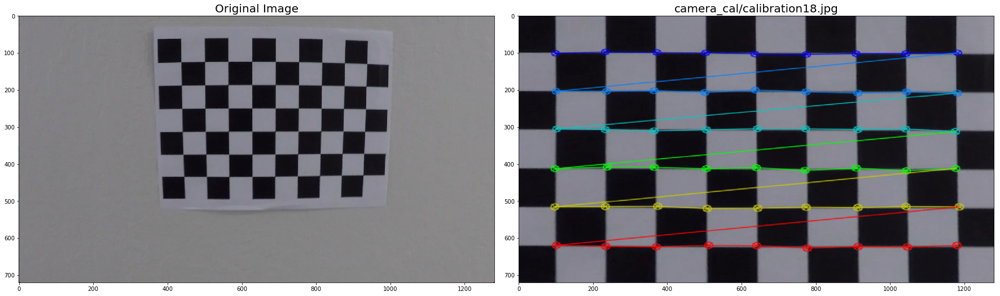

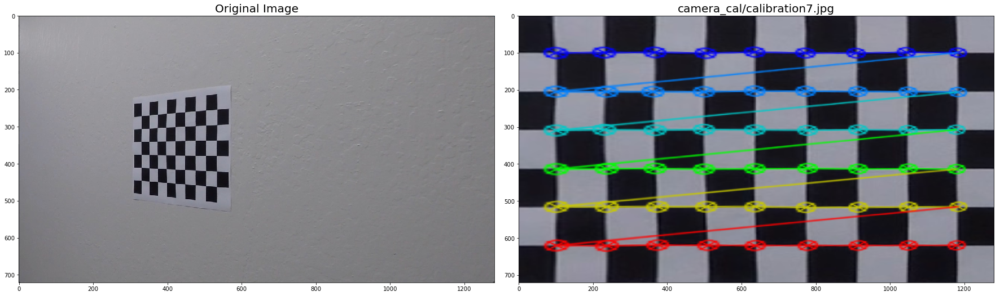

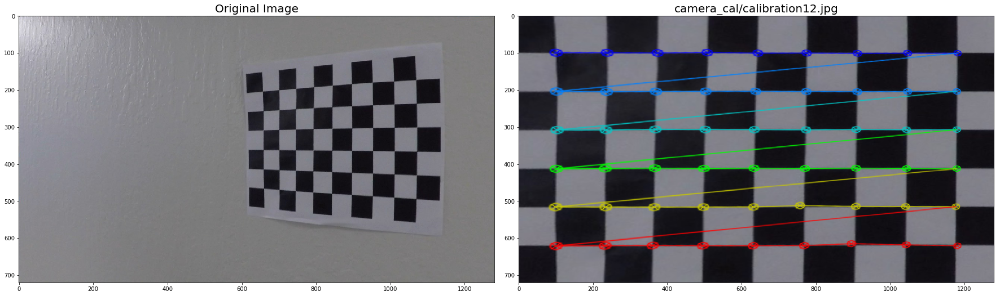

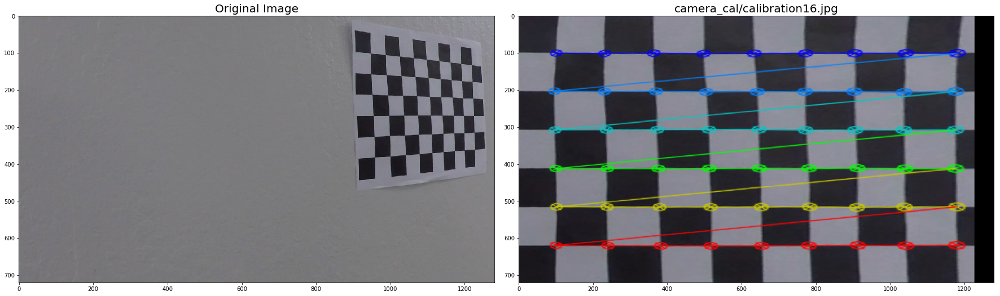

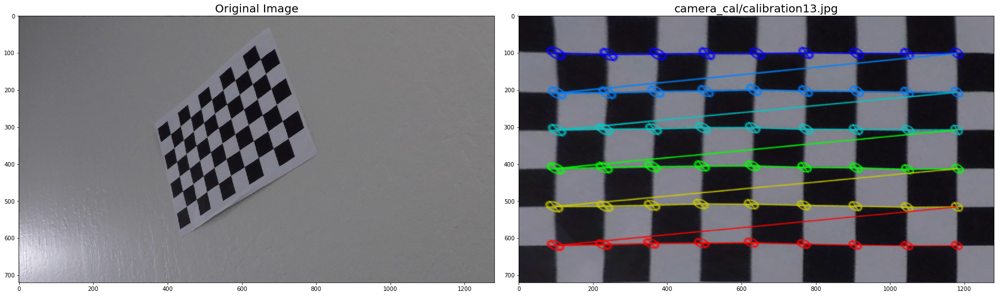

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


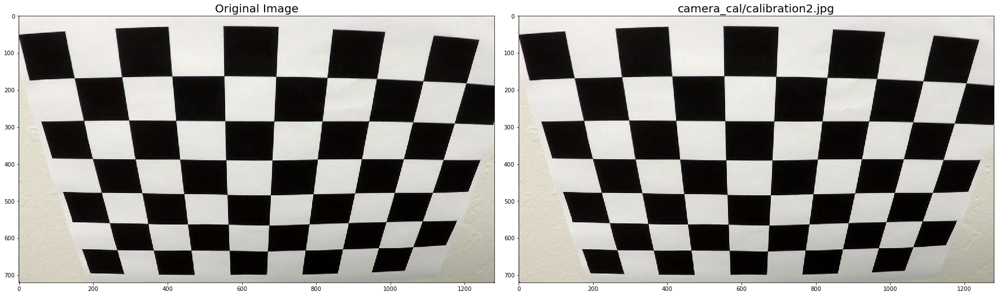

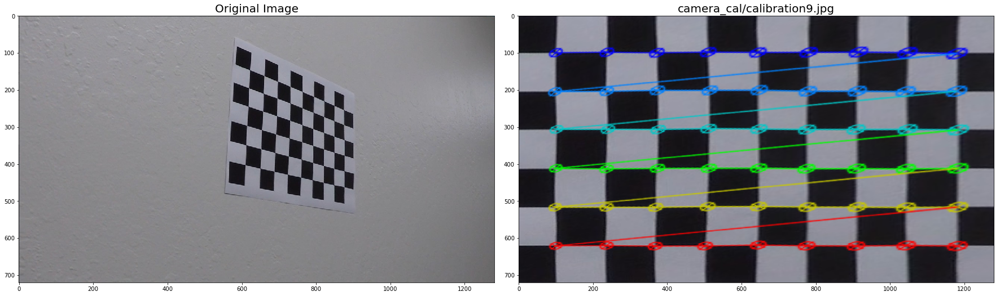

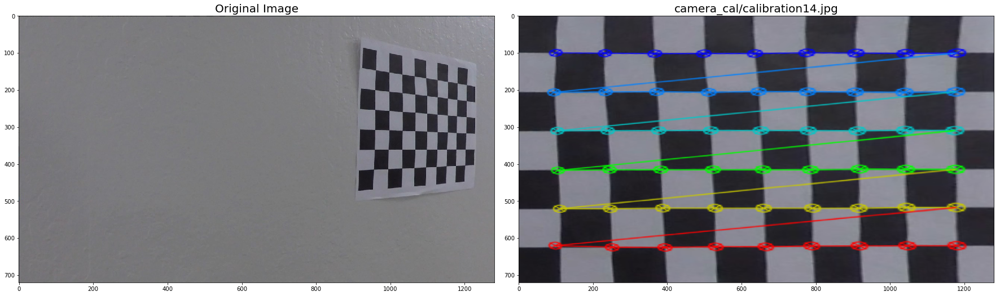

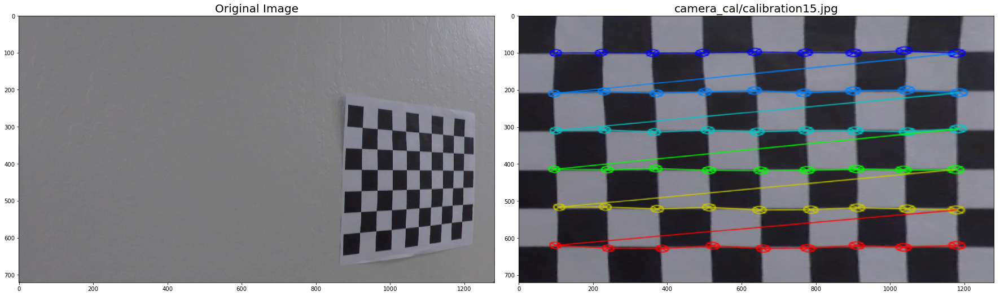

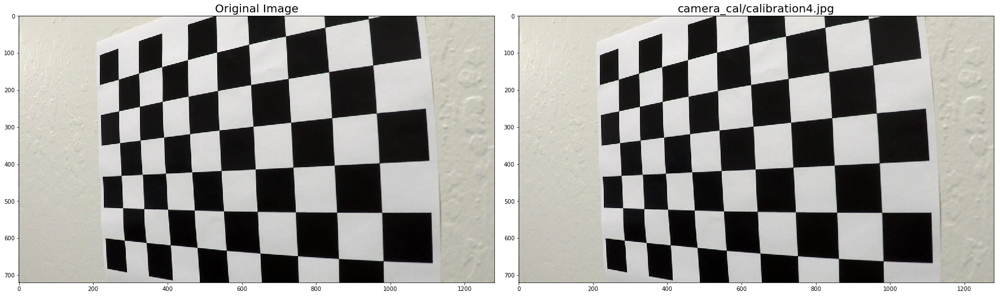

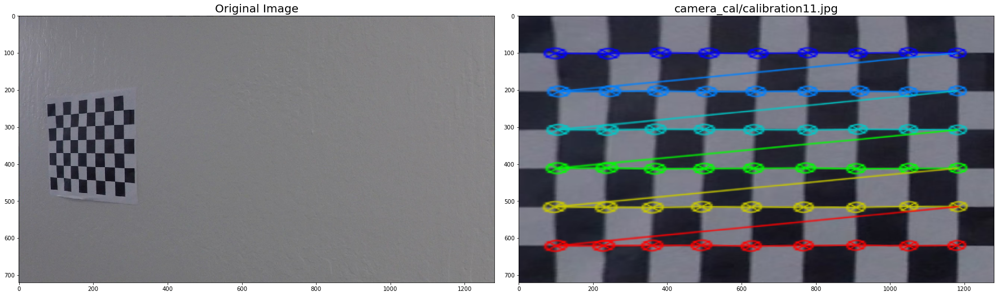

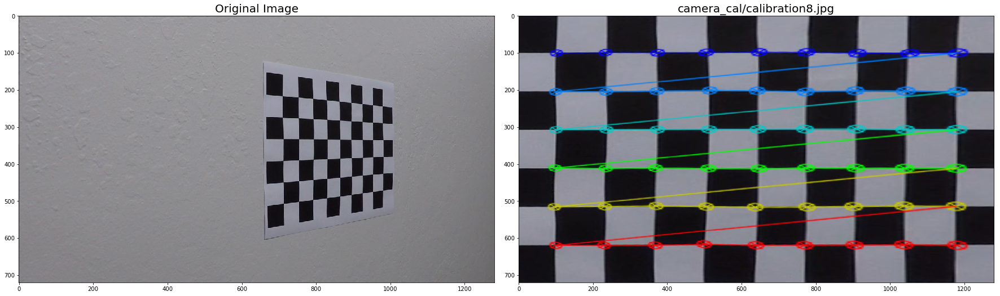

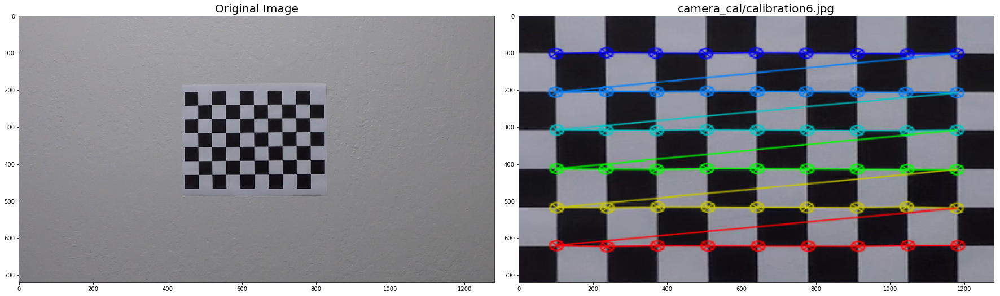

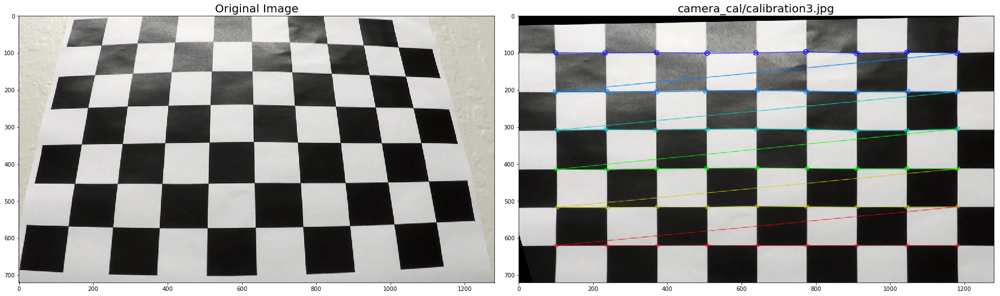

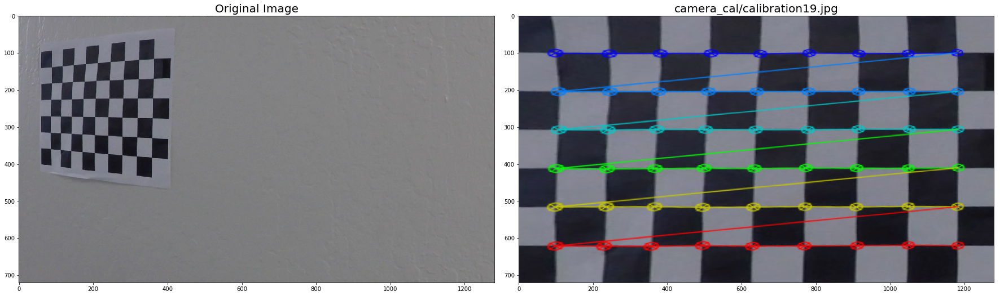

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


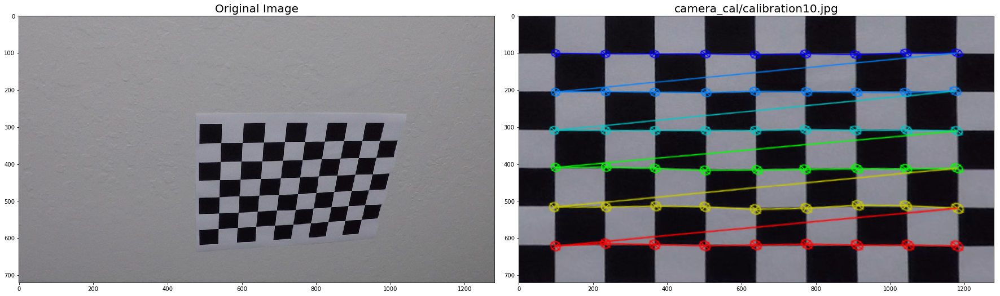

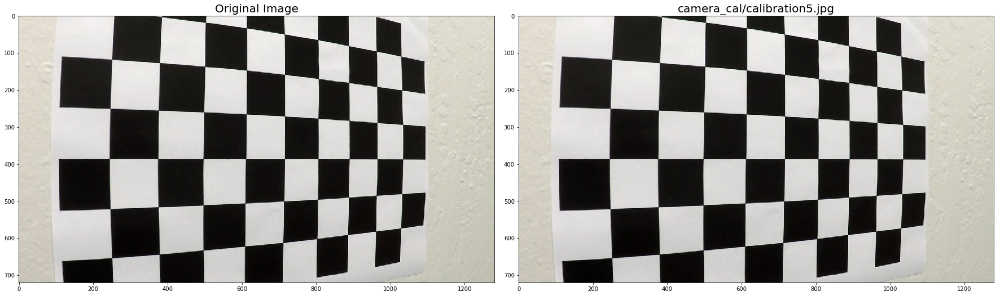

In [40]:
import glob
# %matplotlib qt

# read in all images and store in an array
images = glob.glob('camera_cal/calibration*.jpg')

# chessboard cols and rows number
cb_col,cb_row = 9,6
chessboard_dim = (cb_col,cb_row)

# get image size
image_cali = mpimg.imread(images[0])  
img_size = image_cali.shape[1::-1]

# # arrays to store object points in 3D and image points in 2D
objpoints = [] # 3D points in real world space 
imgpoints = [] # 2D points in image plane

# # prepare object points, like (0,0,0),(1,0,0)...
objp = np.zeros((cb_row*cb_col,3),np.float32)
objp[:,:2] = np.mgrid[0:cb_col,0:cb_row].T.reshape(-1,2) # x,y coordinates

# iterate over all images and fill in objpoints and imgpoints
for frame in images:
    # read in each image
    image = mpimg.imread(frame)
    
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim)    
    # if corners are found, add object points and image points
    if ret:
        imgpoints.append(corners)
        objpoints.append(objp)
        
#use obtained object points and image points to calibrate camera
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints,img_size, None, None)

def camera_calibrate(img = None,mtx = None, dist=None):
    
#     img = np.copy(image)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    # convert to grayscale image
    gray = cv2.cvtColor(undist,cv2.COLOR_RGB2GRAY)
    
    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim, None)

    # use calibrated camera mtx, dist to undistort raw image
    warped, M, Minv = img,None,None
    
    if ret == True:    
        # if found, draw corners on chessboard
        cv2.drawChessboardCorners(undist, chessboard_dim, corners, ret)
        
        offset = 100
        
        src = np.float32([corners[0],corners[cb_col-1],corners[-1],corners[-cb_col]])
        # define 4 destination points                
        dst = np.float32([[offset,offset],
                          [img_size[0]-offset,offset],
                          [img_size[0]-offset,img_size[1]-offset],
                          [offset,img_size[1]-offset]])
        # get M and Minv, the transform matrix and the inverse matrix
        M = cv2.getPerspectiveTransform(src, dst)
        Minv = cv2.getPerspectiveTransform(dst,src)
        # warp image to a top-down view
        warped = cv2.warpPerspective(undist, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped, M, Minv


# images = ['camera_cal/calibration1.jpg','camera_cal/calibration2.jpg','camera_cal/calibration3.jpg',
#           'camera_cal/calibration4.jpg','camera_cal/calibration5.jpg']
for image in images:    
    test_img = mpimg.imread(image) 
    top_down, perspective_M, perspective_Minv = camera_calibrate(test_img,mtx,dist)
        
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(test_img)
    ax1.set_title('Original Image', fontsize=20)
    
    ax2.imshow(top_down)
    ax2.set_title(image, fontsize=20)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


** We see that most of input images are well undistorted and transformed for perspective except for four of them,however this is enough for calibrating the camera, so we move to next. **

## 2. Pipeline (single images)


### 2.1. Provide an example of a distortion-corrected image.

To demonstrate this step, I will describe how I apply the distortion correction to one of the test images like this one:

In [ ]:
#TODO

### 2.2. Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image.  Provide an example of a binary image result.

I used a combination of color and gradient thresholds to generate a binary image (thresholding steps at lines # through # in `another_file.py`).  Here's an example of my output for this step.  (note: this is not actually from one of the test images)

### 2.3. Describe how (and identify where in your code) you performed a perspective transform and provide an example of a transformed image.

The code for my perspective transform includes a function called `warper()`, which appears in lines 1 through 8 in the file `example.py` (output_images/examples/example.py) (or, for example, in the 3rd code cell of the IPython notebook).  The `warper()` function takes as inputs an image (`img`), as well as source (`src`) and destination (`dst`) points.  I chose the hardcode the source and destination points in the following manner:

```python
src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 10), img_size[1]],
    [(img_size[0] * 5 / 6) + 60, img_size[1]],
    [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])
```

This resulted in the following source and destination points:

| Source        | Destination   | 
|:-------------:|:-------------:| 
| 585, 460      | 320, 0        | 
| 203, 720      | 320, 720      |
| 1127, 720     | 960, 720      |
| 695, 460      | 960, 0        |

I verified that my perspective transform was working as expected by drawing the `src` and `dst` points onto a test image and its warped counterpart to verify that the lines appear parallel in the warped image.

![alt text][image4]

In [ ]:
#TODO

### 2.4. Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?

Then I did some other stuff and fit my lane lines with a 2nd order polynomial kinda like this:

![alt text][image5]

In [ ]:
#TODO

### 2.5. Describe how (and identify where in your code) you calculated the radius of curvature of the lane and the position of the vehicle with respect to center.

I did this in lines # through # in my code in `my_other_file.py`


In [ ]:
#TODO

### 2.6. Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.

I implemented this step in lines # through # in my code in `yet_another_file.py` in the function `map_lane()`.  Here is an example of my result on a test image:

![alt text][image6]

In [ ]:
#TODO

## 3. Pipeline (video)

#### 1. Provide a link to your final video output.  Your pipeline should perform reasonably well on the entire project video (wobbly lines are ok but no catastrophic failures that would cause the car to drive off the road!).

Here's a [link to my video result](./project_video.mp4)

### 4. Discussion

#### 1. Briefly discuss any problems / issues you faced in your implementation of this project.  Where will your pipeline likely fail?  What could you do to make it more robust?

Here I'll talk about the approach I took, what techniques I used, what worked and why, where the pipeline might fail and how I might improve it if I were going to pursue this project further.  